# Will it rain tomorrow in Australia?

In [1]:
import numpy as np
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler



## Loading Data

In [24]:
df = pd.read_csv('../data/weatherAUS.csv')

In [25]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [26]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


## Data Preprocessing

In [27]:
null_count = df.isnull().sum().sort_values(ascending=False)
percent_null = (df.isnull().sum() / df.isnull().count()).sort_values(ascending=False)

missing_data = pd.concat([null_count, percent_null], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
Sunshine,69835,0.480098
Evaporation,62790,0.431665
Cloud3pm,59358,0.408071
Cloud9am,55888,0.384216
Pressure9am,15065,0.103568
Pressure3pm,15028,0.103314
WindDir9am,10566,0.072639
WindGustDir,10326,0.070989
WindGustSpeed,10263,0.070555
Humidity3pm,4507,0.030984


In [28]:
# Dropping features where there is more then 15% of missing data

dropList = list(missing_data[missing_data['Percent'] > 0.15].index)
df.drop(dropList, axis=1, inplace=True)

In [29]:
df.shape

(145460, 19)

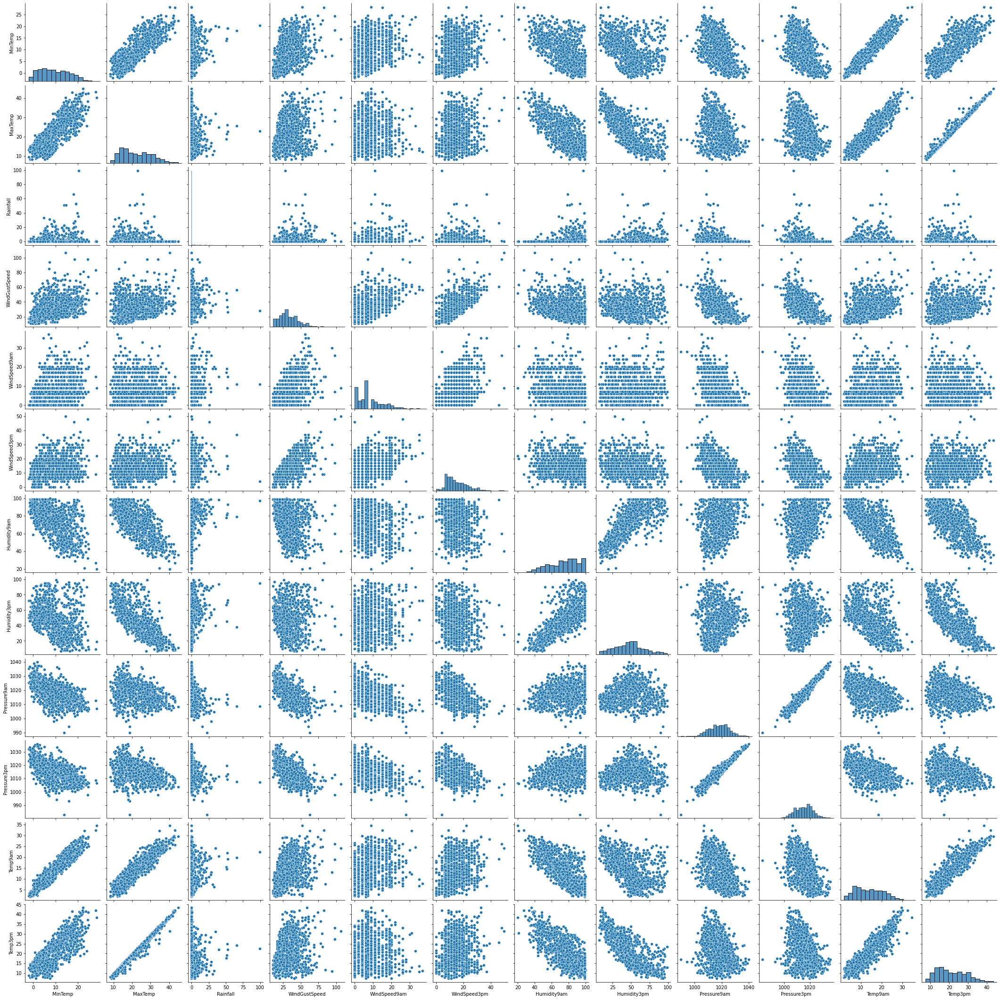

In [30]:
# Plotting a pairplot to help visualize dependencies and correlation between features

sns.pairplot(df[:1000])
plt.show()

In [31]:
# Dropping relevant features
df.drop(['Date'], axis=1, inplace=True)
df.drop(['Location'], axis=1, inplace=True)

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 17 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   MinTemp        143975 non-null  float64
 1   MaxTemp        144199 non-null  float64
 2   Rainfall       142199 non-null  float64
 3   WindGustDir    135134 non-null  object 
 4   WindGustSpeed  135197 non-null  float64
 5   WindDir9am     134894 non-null  object 
 6   WindDir3pm     141232 non-null  object 
 7   WindSpeed9am   143693 non-null  float64
 8   WindSpeed3pm   142398 non-null  float64
 9   Humidity9am    142806 non-null  float64
 10  Humidity3pm    140953 non-null  float64
 11  Pressure9am    130395 non-null  float64
 12  Pressure3pm    130432 non-null  float64
 13  Temp9am        143693 non-null  float64
 14  Temp3pm        141851 non-null  float64
 15  RainToday      142199 non-null  object 
 16  RainTomorrow   142193 non-null  object 
dtypes: float64(12), object(5)
mem

In [40]:
# One-hot-encoding catecorical variables

df_ohe = pd.get_dummies(data=df, columns=['WindGustDir','WindDir9am','WindDir3pm'])
df_ohe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 62 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   MinTemp          143975 non-null  float64
 1   MaxTemp          144199 non-null  float64
 2   Rainfall         142199 non-null  float64
 3   WindGustSpeed    135197 non-null  float64
 4   WindSpeed9am     143693 non-null  float64
 5   WindSpeed3pm     142398 non-null  float64
 6   Humidity9am      142806 non-null  float64
 7   Humidity3pm      140953 non-null  float64
 8   Pressure9am      130395 non-null  float64
 9   Pressure3pm      130432 non-null  float64
 10  Temp9am          143693 non-null  float64
 11  Temp3pm          141851 non-null  float64
 12  RainToday        142199 non-null  object 
 13  RainTomorrow     142193 non-null  object 
 14  WindGustDir_E    145460 non-null  uint8  
 15  WindGustDir_ENE  145460 non-null  uint8  
 16  WindGustDir_ESE  145460 non-null  uint

In [41]:
# Binarazing Yes/No features

df_ohe['RainToday'] = df['RainToday'].astype(str)
df_ohe['RainTomorrow'] = df['RainTomorrow'].astype(str)

lb = preprocessing.LabelBinarizer()

df_ohe['RainToday'] = lb.fit_transform(df_ohe['RainToday'])
df_ohe['RainTomorrow'] = lb.fit_transform(df_ohe['RainTomorrow'])

In [55]:
prepro_df = df_ohe.dropna()
prepro_df.head(5)

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,...,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
0,13.4,22.9,0.6,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,...,0,0,0,0,0,0,0,0,1,0
1,7.4,25.1,0.0,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,...,0,0,0,0,0,0,0,0,0,1
2,12.9,25.7,0.0,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,...,0,0,0,0,0,0,0,0,0,1
3,9.2,28.0,0.0,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,...,0,0,0,0,0,0,0,0,0,0
4,17.5,32.3,1.0,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,...,0,1,0,0,0,0,0,0,0,0


## Building the Model

In [58]:
y = prepro_df['RainTomorrow']
X = prepro_df.drop(['RainTomorrow'], axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

In [59]:
num_estimators = 200

pipe = Pipeline([('scaler', StandardScaler()), ('RFC', RandomForestClassifier(criterion='gini', 
                                                                            max_depth=10, 
                                                                            max_features='auto',
                                                                            n_estimators=num_estimators))])


In [60]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('RFC',
                 RandomForestClassifier(max_depth=10, n_estimators=200))])

## Evaluating the Model 

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score


In [61]:
pipe.score(X_train, y_train)

0.8588279970569388

In [62]:
cross_val_score(pipe, X, y, cv=3)

array([0.83273108, 0.84147831, 0.8413537 ])

In [63]:
y_pred = pipe.predict(X_test)

accuracy_score(y_test, y_pred)

0.846711892565416

In [64]:
f1_score(y_test, y_pred)



0.9074959061591418

In [65]:
confusion_matrix(y_test, y_pred)


array([[ 3424,  4561],
       [  975, 27155]])

## Precision-recall curve and ROC.

No Skill: ROC AUC=0.500
RFC: ROC AUC=0.863


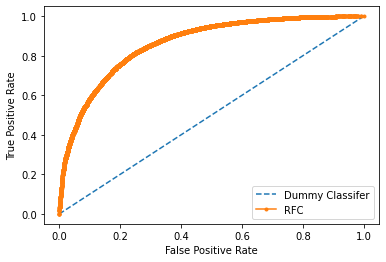

In [66]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

ns_probs = [0 for _ in range(len(y_test))]
lr_probs = pipe.predict_proba(X_test)
lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('RFC: ROC AUC=%.3f' % (lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Dummy Classifer')
plt.plot(lr_fpr, lr_tpr, marker='.', label='RFC')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# show the plot
plt.show()

**Let's plot a graph to identify the threshold influence on the scores**

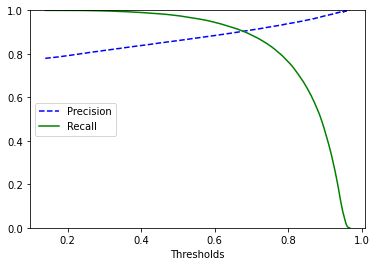

In [67]:
from sklearn.metrics import precision_recall_curve
y_scores = pipe.predict_proba(X_train)[:,1]
#y_scores

precisions, recalls, thresholds = precision_recall_curve(y_train, y_scores)

def plot_prc (precisions, recalls, thresholds):
    plt.plot(thresholds, precisions[:-1], 'b--', label='Precision')
    plt.plot(thresholds, recalls[:-1], 'g-', label='Recall')
    plt.xlabel('Thresholds')
    plt.legend(loc='center left')
    plt.ylim([0,1])

plot_prc(precisions, recalls, thresholds)

## Train and Evaluate functions

In [106]:
import pandas as pd
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import  accuracy_score, f1_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

def train(data, num_estimators, isDataFrame=False):

    if not isDataFrame:
        data = pd.read_csv(data)

    # Seperating the dependant and independant variables
    y = data['RainTomorrow']
    X = data.drop(['RainTomorrow'], axis=1)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

    pipe = Pipeline([('scaler', StandardScaler()), ('RFC', RandomForestClassifier(criterion='gini', 
                                                                              max_depth=10, 
                                                                              max_features='auto',
                                                                              n_estimators=num_estimators))])


    training_logs = pipe.fit(X_train, y_train)

    def comb_eval(y, y_pred):
        acc = accuracy_score(y, y_pred)
        f1 = f1_score(y, y_pred)
        
        return {"acc": acc, "f1": f1}
    y_pred_train = pipe.predict(X_train)
    train_result = comb_eval(y_train, y_pred_train)

    y_pred_test = pipe.predict(X_test)
    test_result = comb_eval(y_test, y_pred_test)

    y_pred = pipe.predict(X_test)

    cvs = cross_val_score(pipe, X, y, cv=3)

    logs = {"training_logs":training_logs, "Evaluation_Metrics":{"train_result": train_result, "test_result": test_result, "cross_val_score":cvs}}

    return pipe, logs